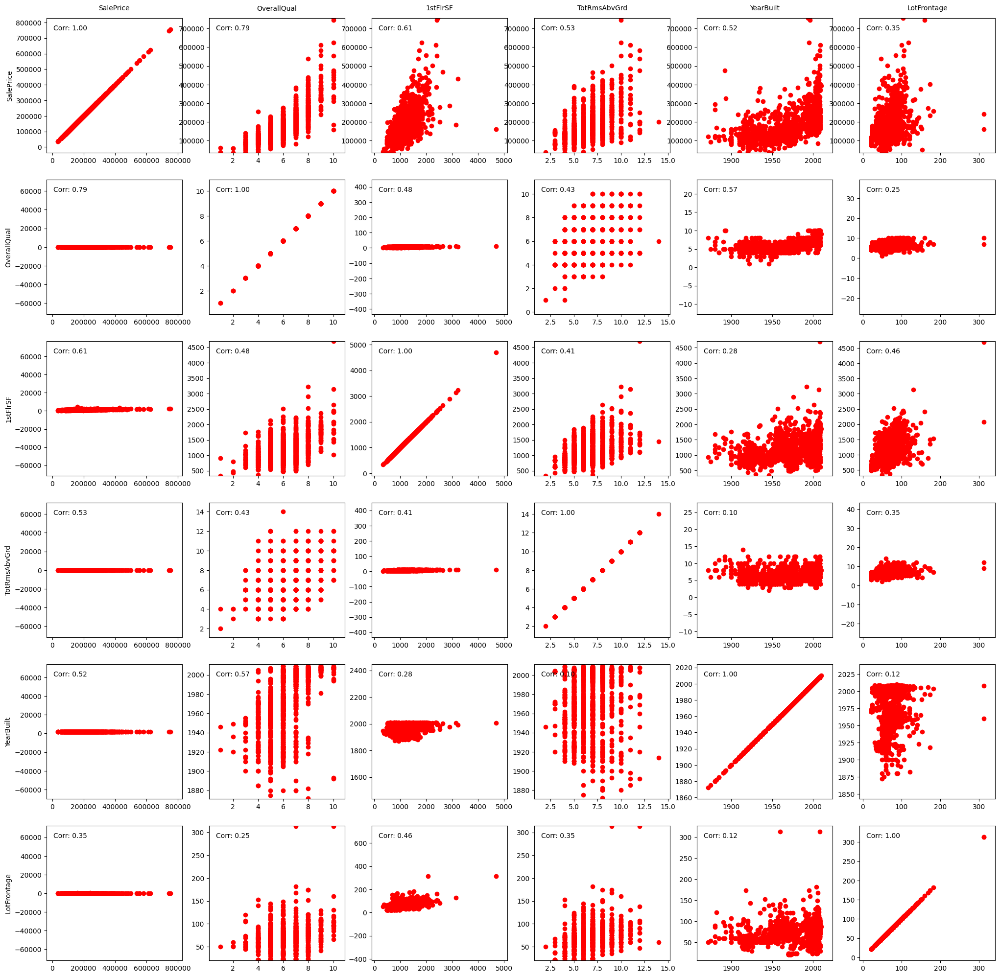

In [1]:
from ML.ML import ML 

# Crear un objeto de la clase ML
ml = ML('./proyecto_data/proyecto_training_data.npy', 0.8)

#ml.hsitograma(ml.datos)	
ml.corrGrafica(ml.datos)


Iteration 1: Cost 2.647904413228098e+16, Weight         237.68874016095788, Bias 36.12793145890394
Iteration 2: Cost 2.608668316193024e+16, Weight         473.3745212303057, Bias 71.94873224891535
Iteration 3: Cost 2.5700586043685972e+16, Weight         707.1725944683097, Bias 107.47478379727886
Iteration 4: Cost 2.5320652776566844e+16, Weight         939.0980889039614, Bias 142.70844844528324
Iteration 5: Cost 2.49467849560846e+16, Weight         1169.1660123146075, Bias 177.6520696012229
Iteration 6: Cost 2.4578885748756396e+16, Weight         1397.3912521977131, Bias 212.307971892139
Iteration 7: Cost 2.4216859867024044e+16, Weight         1623.7885767348528, Bias 246.67846131434288
Iteration 8: Cost 2.38606135445737e+16, Weight         1848.372635747952, Bias 280.7658253827287
Iteration 9: Cost 2.351005451204954e+16, Weight         2071.157961647905, Bias 314.57233327889514
Iteration 10: Cost 2.3165091973155132e+16, Weight         2292.15897037555, Bias 348.1002359980779
Iteration 

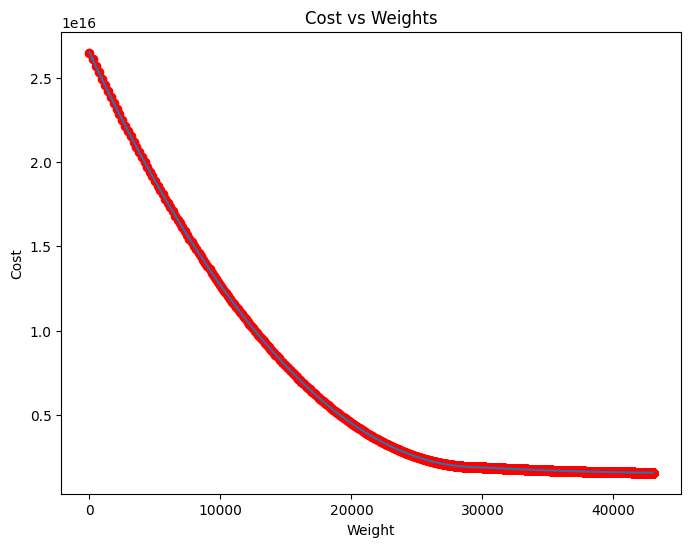

Estimated Weight: 43036.514670046876
Estimated Bias: -81256.37295041257 
 error 1572307700625371.5


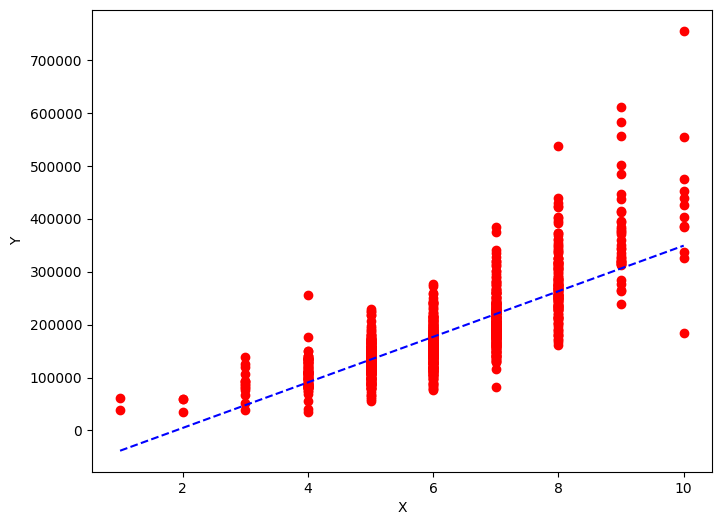

In [13]:
# Importing Libraries
import numpy as np
import matplotlib.pyplot as plt

####################33
import numpy as np
import pandas as pd

def npyToPandas(direccion):
    datos = np.load(direccion)
    return pd.DataFrame(datos,columns=[
    'SalePrice', 
    'OverallQual',
    '1stFlrSF',
    'TotRmsAbvGrd',
    'YearBuilt',
    'LotFrontage'])

def separacionData(data,segmentacion = 0.8):
    entrenamiento = data[0:int(len(data)*segmentacion)]
    validacion= data[int(len(data)*segmentacion):]
    return entrenamiento,validacion

data = npyToPandas('./proyecto_data/proyecto_training_data.npy')
#data = npyToPandas('../../proyecto 1/Proyecto-1---Regresi-n-con-Progra-/proyecto_data/proyecto_training_data.npy')

ent,val = separacionData(data,0.8)

#############33




def mean_squared_error(y_true, y_predicted):
#     
    # Calculating the loss or cost
    cost = np.sum((y_true-y_predicted)**2) / len(y_true)
    return cost
#
# Gradient Descent Function
# Here iterations, learning_rate, stopping_threshold
# are hyperparameters that can be tuned
def gradient_descent(x, y, iterations = 1000, learning_rate = 0.0001,
                     stopping_threshold = 1e-6):
    # 
    # Initializing weight, bias, learning rate and iterations
    current_weight = 0.1
    current_bias = 0.01
    iterations = iterations
    learning_rate = learning_rate
    n = float(len(x))
    #
    costs = []
    weights = []
    previous_cost = None
     
    # Estimation of optimal parameters
    for i in range(iterations):
        #
        # Making predictions
        y_predicted = (current_weight * x) + current_bias
        #
        # Calculating the current cost
        current_cost = np.sum((y-y_predicted)**2) /2 *len(y) 
        #
        # If the change in cost is less than or equal to
        # stopping_threshold we stop the gradient descent
        if previous_cost and abs(previous_cost-current_cost)<=stopping_threshold:
            break
        #
        previous_cost = current_cost
        #
        costs.append(current_cost)
        weights.append(current_weight)
        #
        # Calculating the gradients
        weight_derivative = -(2/n) * sum(x * (y-y_predicted))
        bias_derivative = -(2/n) * sum(y-y_predicted)
        # 
        # Updating weights and bias
        current_weight = current_weight - (learning_rate * weight_derivative)
        current_bias = current_bias - (learning_rate * bias_derivative)
        #        
        # Printing the parameters for each 1000th iteration
        print(f"Iteration {i+1}: Cost {current_cost}, Weight \
        {current_weight}, Bias {current_bias}")
     
     
    # Visualizing the weights and cost at for all iterations
    plt.figure(figsize = (8,6))
    plt.plot(weights, costs)
    plt.scatter(weights, costs, marker='o', color='red')
    plt.title("Cost vs Weights")
    plt.ylabel("Cost")
    plt.xlabel("Weight")
    plt.show()
     
    return current_weight, current_bias,costs
 
 
def main():

    data = npyToPandas('./proyecto_data/proyecto_training_data.npy')
    #data = npyToPandas('../../proyecto 1/Proyecto-1---Regresi-n-con-Progra-/proyecto_data/proyecto_training_data.npy')

    ent,val = separacionData(data,0.8)
    
     
    # Data
    X = np.array([32.50234527, 53.42680403, 61.53035803, 47.47563963, 59.81320787,
           55.14218841, 52.21179669, 39.29956669, 48.10504169, 52.55001444,
           45.41973014, 54.35163488, 44.1640495 , 58.16847072, 56.72720806,
           48.95588857, 44.68719623, 60.29732685, 45.61864377, 38.81681754])
    Y = np.array([31.70700585, 68.77759598, 62.5623823 , 71.54663223, 87.23092513,
           78.21151827, 79.64197305, 59.17148932, 75.3312423 , 71.30087989,
           55.16567715, 82.47884676, 62.00892325, 75.39287043, 81.43619216,
           60.72360244, 82.89250373, 97.37989686, 48.84715332, 56.87721319])
    
    X=ent.iloc[:,1].values
    Y=ent.iloc[:,0].values
    # Estimating weight and bias using gradient descent
    estimated_weight, estimated_bias,costs = gradient_descent(X, Y, iterations=200000)
    print(f"Estimated Weight: {estimated_weight}\nEstimated Bias: {estimated_bias} \n error {costs[-1]}")
 
    # Making predictions using estimated parameters
    Y_pred = estimated_weight*X + estimated_bias
 
    # Plotting the regression line
    plt.figure(figsize = (8,6))
    plt.scatter(X, Y, marker='o', color='red')
    plt.plot([min(X), max(X)], [min(Y_pred), max(Y_pred)], color='blue',markerfacecolor='red',
             markersize=10,linestyle='dashed')
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.show()
 
     
if __name__=="__main__":
    main()